# Importing Libraries, Loading Data and Other Good Stuff

In [1]:
%load_ext nb_black
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from geopandas.plotting import _PolygonPatch
from shapely.affinity import scale

<IPython.core.display.Javascript object>

In [2]:
econ_survey = pd.read_csv("economic_survey_2021.csv")

<IPython.core.display.Javascript object>

In [3]:
econ_survey.head()

,SLno,Name,GDDP_Current,GDDP_Constant,NDDP_Current,NDDP_Constant,Per_Capita_Income_Current,Per_Capita_Income_Constant
0,1,Bagalkot,3962658,2780240,3538919,2443926,173080,119526
1,2,Bengaluru (Urban),59629019,42474894,56386342,39848837,541638,382781
2,3,Bengaluru (Rural),2462358,1787167,2198854,1573375,205086,146748
3,4,Belagavi,6894338,4719045,6025322,4025179,116510,77834
4,5,Ballari,5228290,3817399,4604875,3312080,173529,124812


<IPython.core.display.Javascript object>

In [4]:
econ_survey = econ_survey[["Name", "GDDP_Current"]]

<IPython.core.display.Javascript object>

In [5]:
districts = gpd.read_file("District.shp")

<IPython.core.display.Javascript object>

In [6]:
districts.head()

,KGISDistri,LGD_Distri,KGISDist_1,BhuCodeDis,created_us,created_da,last_edite,last_edi_1,SHAPE_STAr,SHAPE_STLe,geometry
0,01,527,Belagavi,01,NaN,NaN,SURESHBV1,2022-11-24,1.339772e+10,1.141488e+06,"MULTIPOLYGON (((537523.310 1865366.861, 537555..."
1,02,524,Bagalkot,02,NaN,NaN,SURESHBV1,2022-09-08,6.561826e+09,6.682456e+05,"POLYGON ((581917.898 1811433.959, 581946.875 1..."
2,03,530,Vijayapura,03,NaN,NaN,SURESHBV1,2022-11-24,1.050271e+10,7.032618e+05,"POLYGON ((537523.310 1865366.861, 537516.168 1..."
3,04,538,Kalburgi,04,NaN,NaN,SURESHBV1,2022-11-09,1.097395e+10,9.181459e+05,"MULTIPOLYGON (((680992.661 1951255.947, 681227..."
4,05,529,Bidar,05,NaN,NaN,SURESHBV1,2022-11-16,5.454415e+09,5.733925e+05,"MULTIPOLYGON (((766506.612 1970249.909, 766481..."


<IPython.core.display.Javascript object>

In [7]:
districts = districts.to_crs("4326")

<IPython.core.display.Javascript object>

In [8]:
econ_survey = econ_survey.rename({"Name": "KGISDist_1"}, axis=1)
econ_survey.head()

,KGISDist_1,GDDP_Current
0,Bagalkot,3962658
1,Bengaluru (Urban),59629019
2,Bengaluru (Rural),2462358
3,Belagavi,6894338
4,Ballari,5228290


<IPython.core.display.Javascript object>

In [9]:
districts = districts.merge(econ_survey)

<IPython.core.display.Javascript object>

# Plotting Shapefiles

<AxesSubplot: >

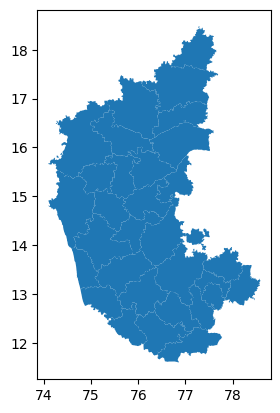

<IPython.core.display.Javascript object>

In [10]:
districts.plot()

<AxesSubplot: >

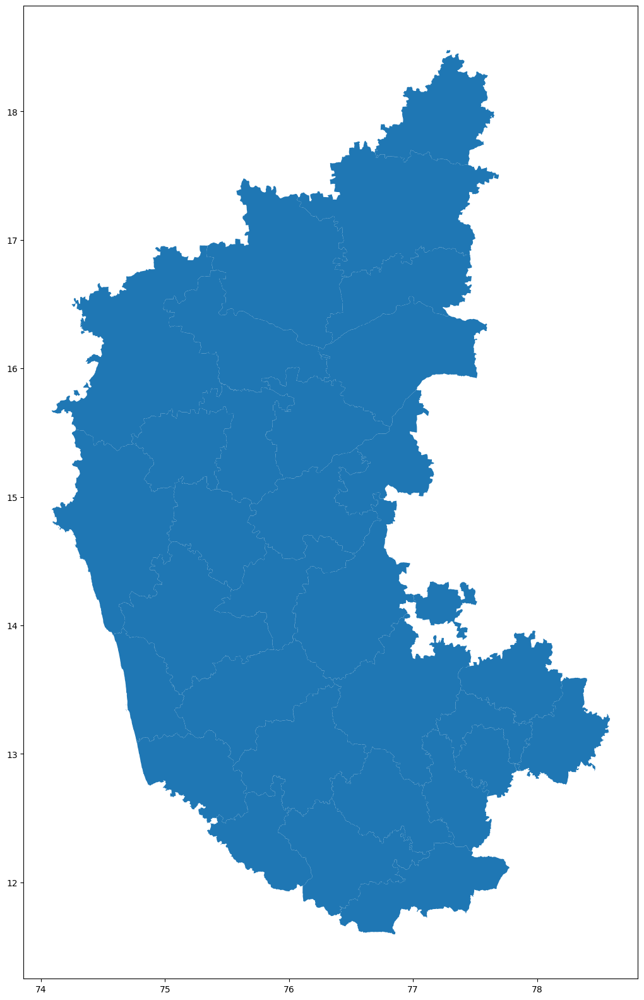

<IPython.core.display.Javascript object>

In [11]:
districts.plot(figsize=(20, 20))

# Choropleth Maps

<AxesSubplot: >

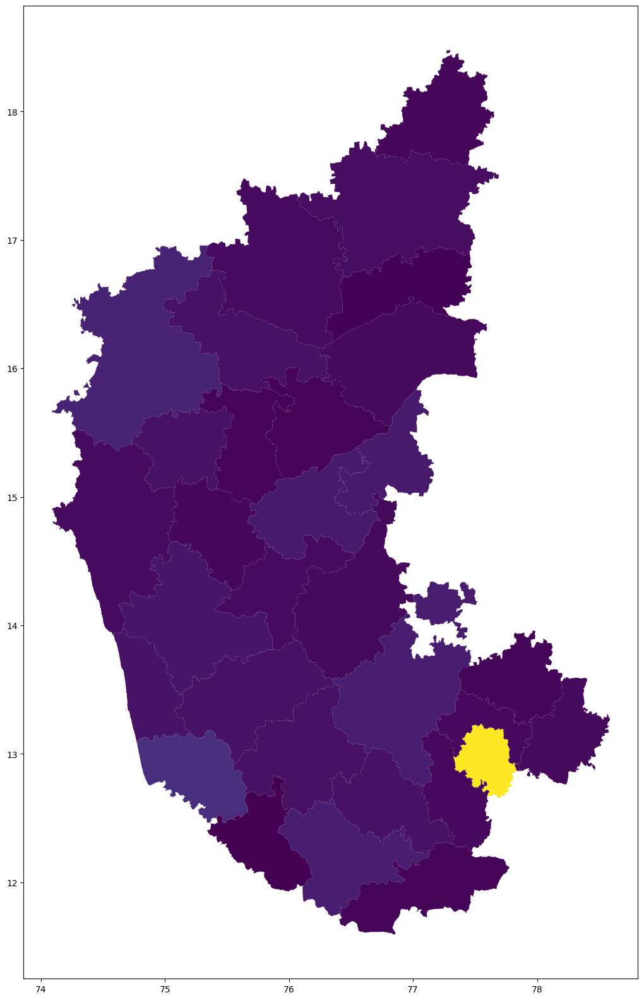

<IPython.core.display.Javascript object>

In [12]:
districts.plot(figsize=(20, 20), column="GDDP_Current")

/home/ambee/mambaforge/lib/python3.10/site-packages/geopandas/plotting.py:642: FutureWarning: 'colormap' is deprecated, please use 'cmap' instead (for consistency with matplotlib)
  warnings.warn(


<AxesSubplot: >

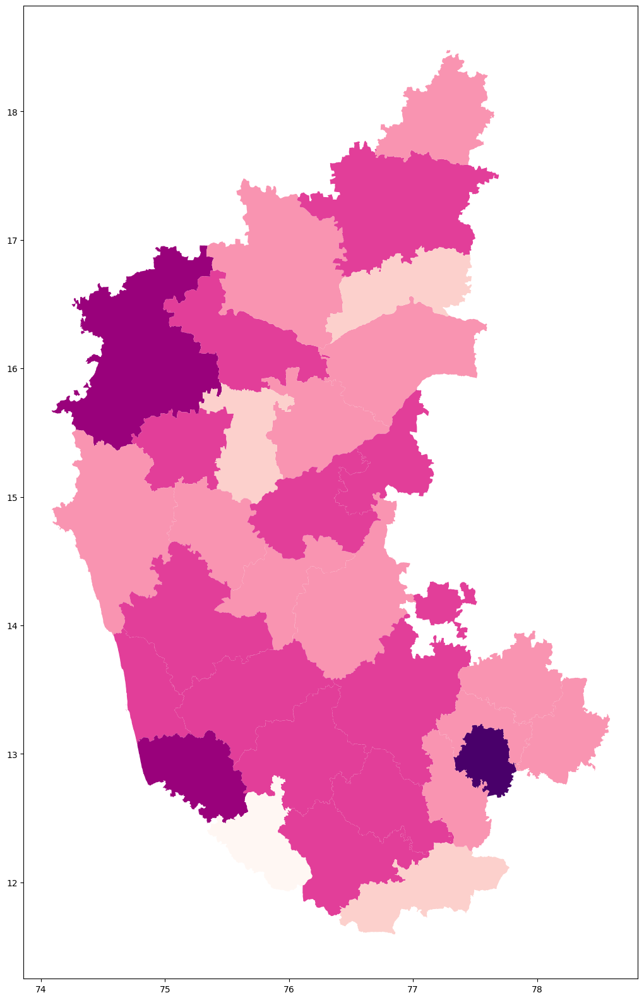

<IPython.core.display.Javascript object>

In [13]:
districts.plot(
    figsize=(20, 20), column="GDDP_Current", colormap="RdPu", scheme="percentiles"
)

<AxesSubplot: >

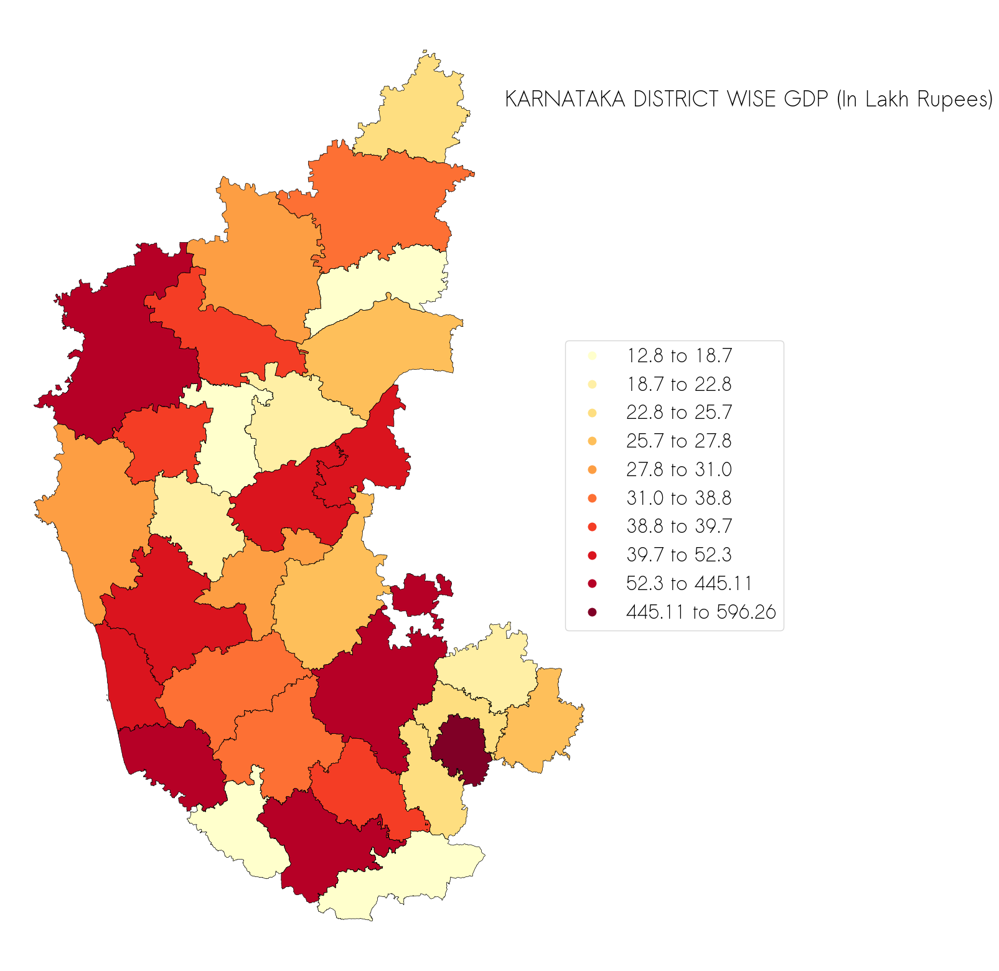

<IPython.core.display.Javascript object>

In [14]:
# Basic figure settings
fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

# Adding Text
ax.text(
    0.67,
    0.8,
    "KARNATAKA DISTRICT WISE GDP (In Lakh Rupees)",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

# Turning off axes
ax.axis("off")

# Plotting district boundaries/outline
ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

# Plotting GDDP Data as Choropleth
districts.plot(
    ax=ax,
    column="GDDP_Current",
    cmap="YlOrRd",
    scheme="percentiles",
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    legend=True,
    legend_kwds={
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
        "loc": "center right",
        "bbox_to_anchor": (1.3, 0.5),
        "prop": {"family": "Sawasdee", "weight": 3, "size": 22},
    },
)

# Bubble Plots

In [15]:
# Convert Polygon to a Point
centroids = districts.copy()
centroids["geometry"] = districts.centroid

/tmp/ipykernel_63524/3652096499.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids["geometry"] = districts.centroid


<IPython.core.display.Javascript object>

<AxesSubplot: >

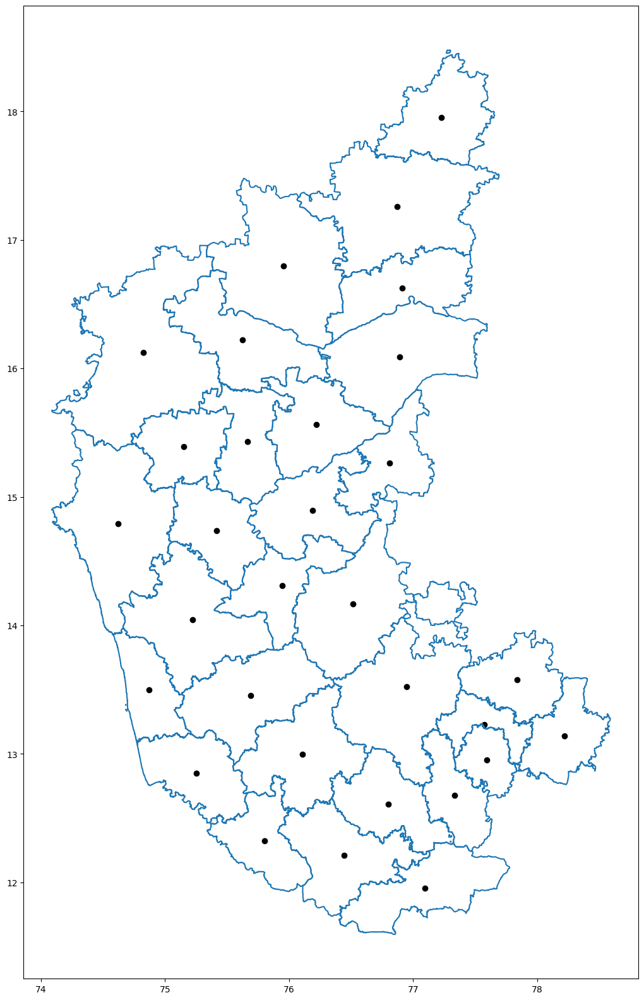

<IPython.core.display.Javascript object>

In [16]:
fig, ax = plt.subplots(figsize=(20, 20))
ax = districts.boundary.plot(ax=ax)
centroids.plot(ax=ax, color="black")

In [17]:
# Makes sure the point is inside the polygon
rep_points = districts.copy()
rep_points["geometry"] = districts.representative_point()

<IPython.core.display.Javascript object>

<AxesSubplot: >

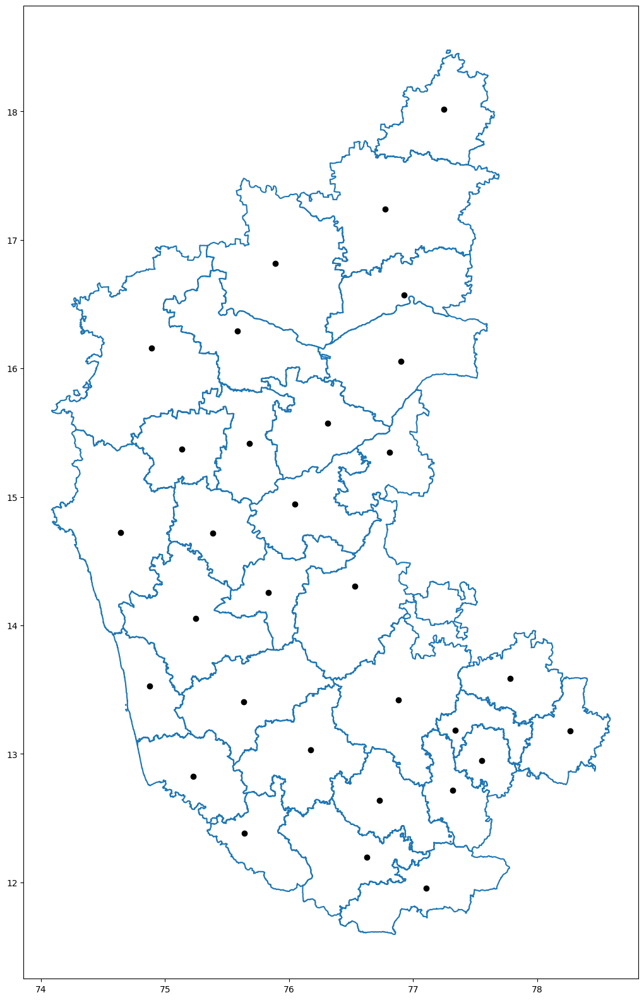

<IPython.core.display.Javascript object>

In [18]:
fig, ax = plt.subplots(figsize=(20, 20))
ax = districts.boundary.plot(ax=ax)
rep_points.plot(ax=ax, color="black")

In [19]:
# Scale these points to fit inside the map
rep_points["size"] = rep_points["GDDP_Current"] / 30000  # 30000 is by trail and error

<IPython.core.display.Javascript object>

<AxesSubplot: >

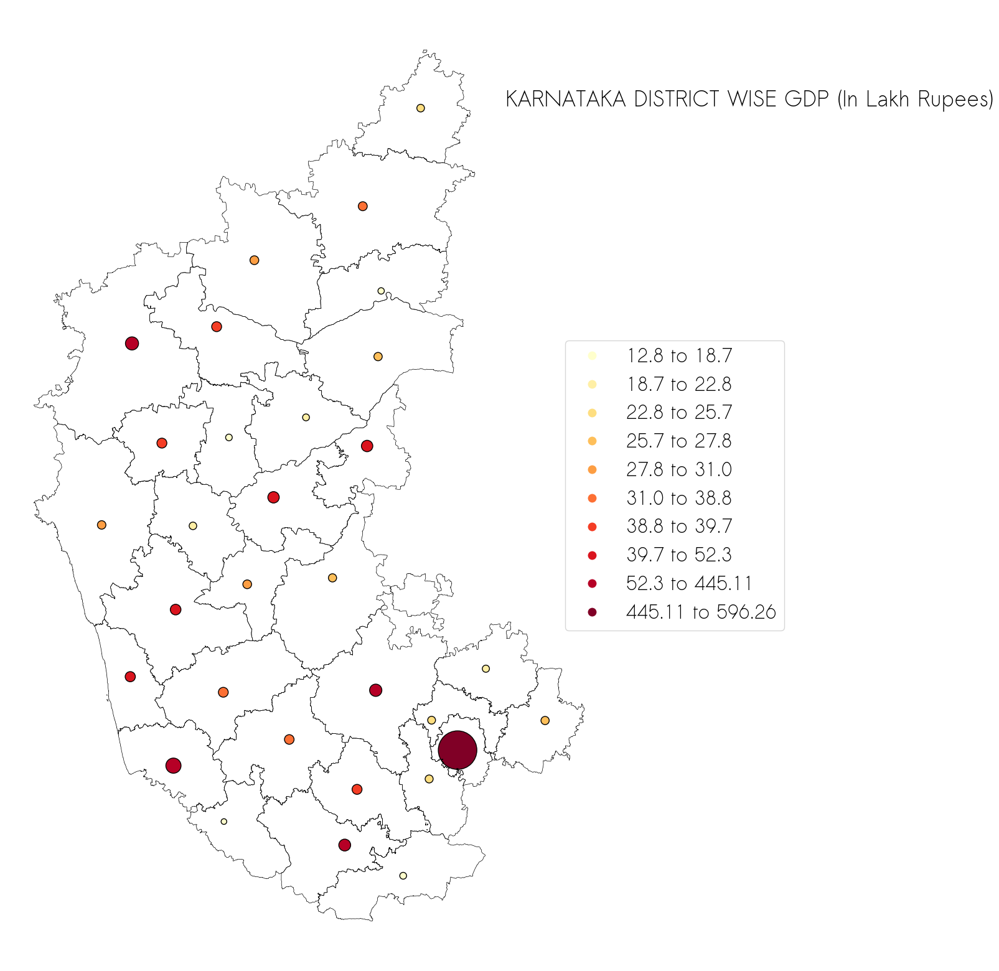

<IPython.core.display.Javascript object>

In [20]:
fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

ax.text(
    0.67,
    0.8,
    "KARNATAKA DISTRICT WISE GDP (In Lakh Rupees)",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

rep_points.plot(
    ax=ax,
    column="GDDP_Current",
    markersize="size",  # For Bubble Plot
    cmap="YlOrRd",
    edgecolor="black",
    scheme="percentiles",
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    legend=True,
    legend_kwds={
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
        "loc": "center right",
        "bbox_to_anchor": (1.3, 0.5),
        "prop": {"family": "Sawasdee", "weight": 3, "size": 22},
    },
)

# Cartogram

In [21]:
cartogram = districts.copy()
cartogram["scale_factor"] = cartogram["GDDP_Current"] / cartogram["GDDP_Current"].max()
cartogram["repr_point"] = cartogram.representative_point()

<IPython.core.display.Javascript object>

In [22]:
# Scale each geometry
scaled_geoms = [
    scale(
        x["geometry"],
        xfact=x["scale_factor"],
        yfact=x["scale_factor"],
        origin=x["repr_point"],
    )
    for x in cartogram.to_dict(orient="records")
]

cartogram["geometry"] = scaled_geoms

<IPython.core.display.Javascript object>

<AxesSubplot: >

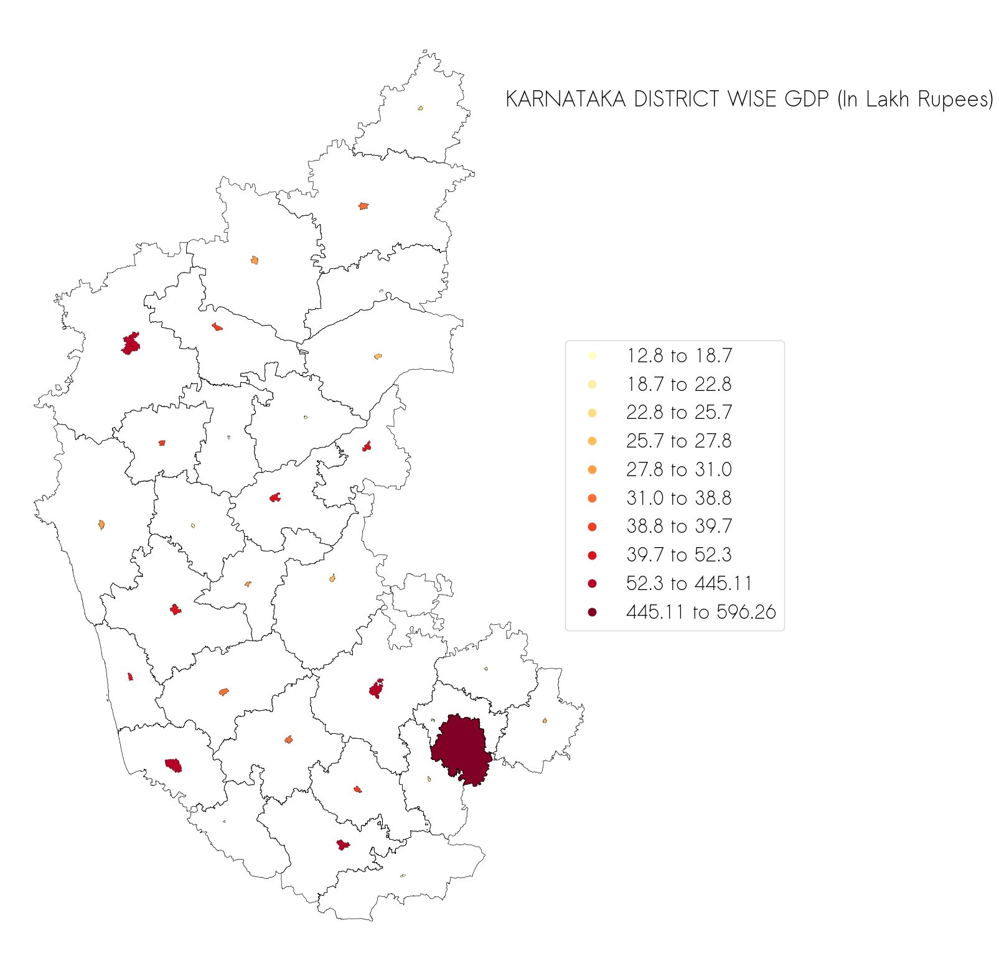

<IPython.core.display.Javascript object>

In [23]:
fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

ax.text(
    0.67,
    0.8,
    "KARNATAKA DISTRICT WISE GDP (In Lakh Rupees)",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)


ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

cartogram.plot(
    ax=ax,
    column="GDDP_Current",
    cmap="YlOrRd",
    edgecolor="black",
    linewidth=0.2,
    scheme="percentiles",
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    legend=True,
    legend_kwds={
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
        "loc": "center right",
        "bbox_to_anchor": (1.3, 0.5),
        "prop": {"family": "Sawasdee", "weight": 3, "size": 22},
    },
)

# Point Plots Revisited, Briefly

In [24]:
assemblies = gpd.read_file("AC_Boundary.shp")
assemblies = assemblies.to_crs("4326")

<IPython.core.display.Javascript object>

<AxesSubplot: >

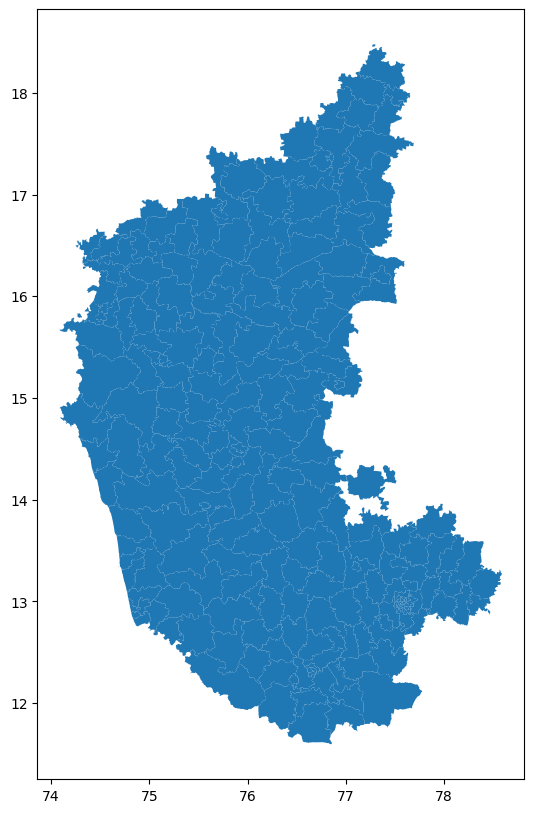

<IPython.core.display.Javascript object>

In [25]:
assemblies.plot(figsize=(10, 10))

In [26]:
assemblies["geometry"] = assemblies.representative_point()

<IPython.core.display.Javascript object>

<AxesSubplot: >

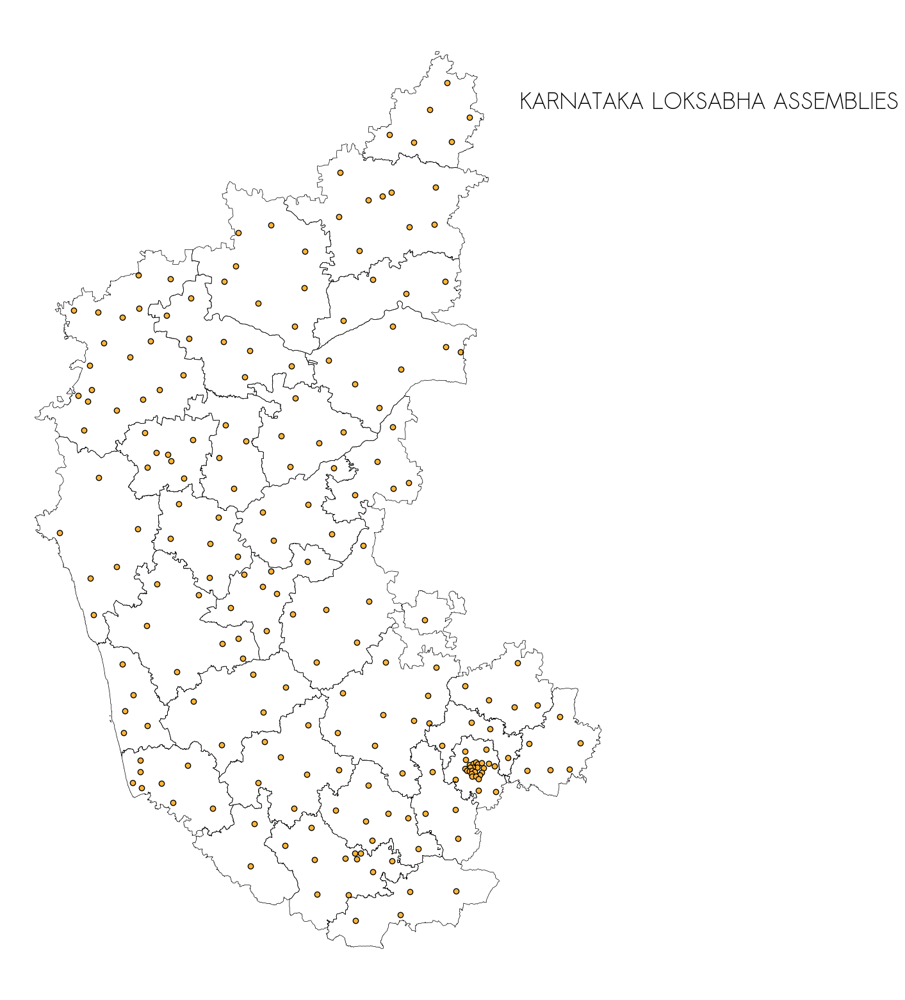

<IPython.core.display.Javascript object>

In [27]:
fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

ax.text(
    0.67,
    0.8,
    "KARNATAKA LOKSABHA ASSEMBLIES",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

assemblies.plot(ax=ax, color="#ffb536", edgecolor="black")

# Density Plots on a Map

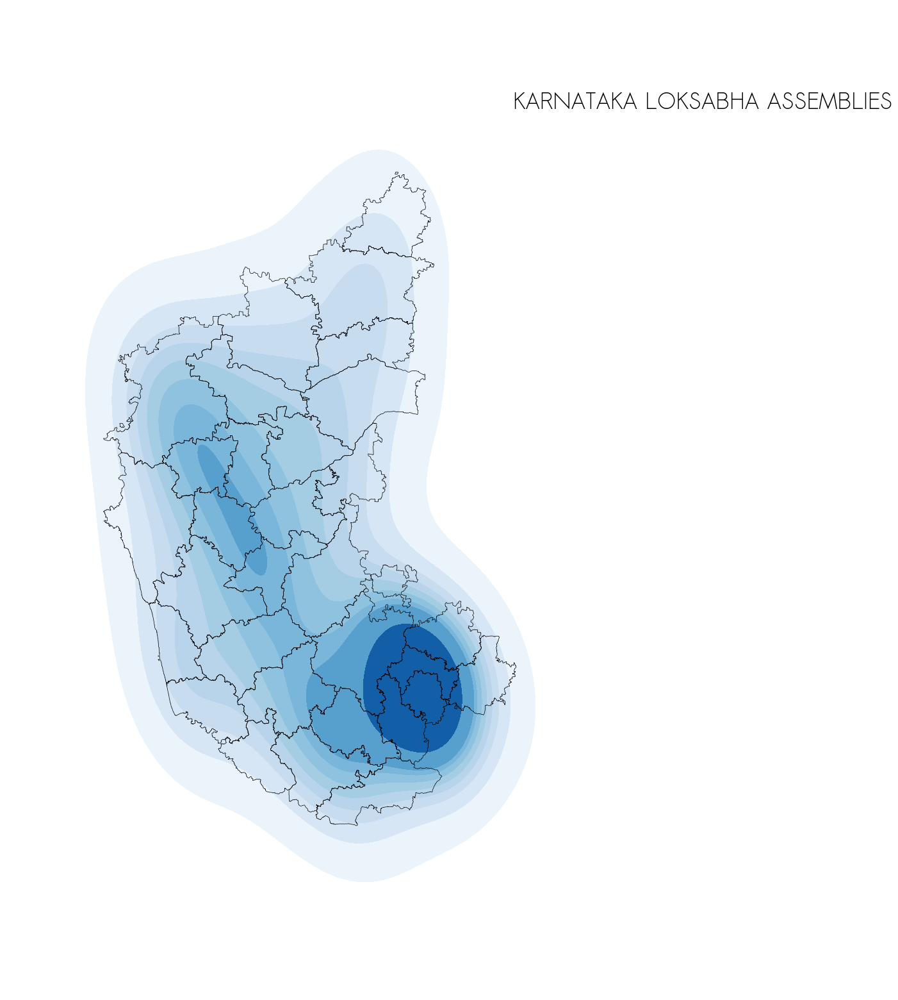

<IPython.core.display.Javascript object>

In [28]:
fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

ax.text(
    0.67,
    0.8,
    "KARNATAKA LOKSABHA ASSEMBLIES",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

# Plot Seaborn kdeplot with x and y values from geometry
kde = sns.kdeplot(
    x=assemblies["geometry"].x, y=assemblies["geometry"].y, fill=True, cmap="Blues"
)

# Clipping the heatmap, not so straight forward

In [29]:
karnataka = districts.copy()
karnataka["dissolve"] = "Dissolve"
karnataka = karnataka.dissolve(by="dissolve")
karnataka = karnataka.geometry[0]

not_karnataka = karnataka.envelope
not_karnataka = scale(not_karnataka.envelope, xfact=1.2, yfact=1.2)
not_karnataka = not_karnataka.difference(karnataka)

<IPython.core.display.Javascript object>

In [30]:
str(type(not_karnataka))

"<class 'shapely.geometry.multipolygon.MultiPolygon'>"

<IPython.core.display.Javascript object>

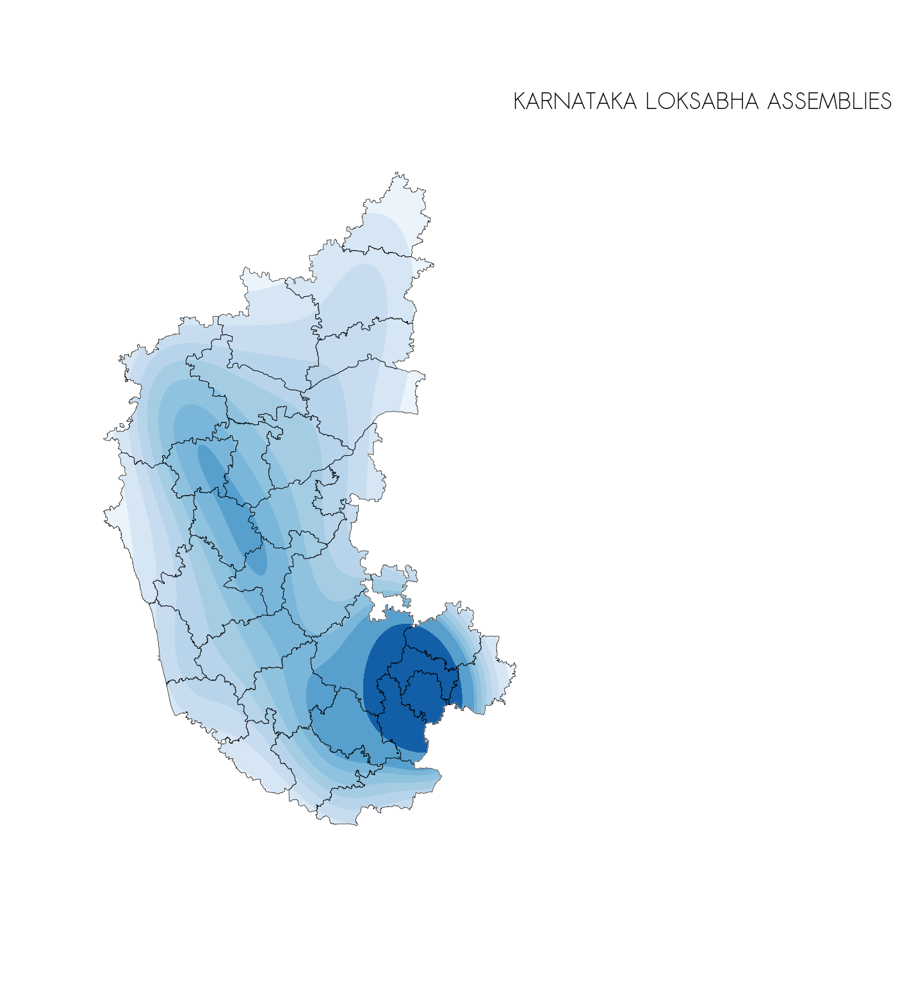

<IPython.core.display.Javascript object>

In [31]:
patches = [
    _PolygonPatch(geom, facecolor="white", edgecolor="white")
    for geom in not_karnataka.geoms
]

fig, ax = plt.subplots(figsize=(20, 20))

ax.text(
    0.67,
    0.8,
    "KARNATAKA LOKSABHA ASSEMBLIES",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)

kde = sns.kdeplot(
    ax=ax,
    x=assemblies["geometry"].x,
    y=assemblies["geometry"].y,
    fill=True,
    cmap="Blues",
)

for patch in patches:
    ax.add_patch(patch)

# Geospatial Heatmaps

In [32]:
karnataka.bounds

(74.08550933255263, 11.59495951530512, 78.58778814477083, 18.47761915178052)

<IPython.core.display.Javascript object>

In [33]:
grid_space = 0.01

grid_lon = np.arange(74.0855, 78.5878 + grid_space, grid_space)
grid_lat = np.arange(11.5949, 18.4777 + grid_space, grid_space)

all_lats = np.meshgrid(grid_lon, grid_lat)[1].ravel()
all_lons = np.meshgrid(grid_lon, grid_lat)[0].ravel()
del grid_lat, grid_lon

pairs = list(zip(all_lats, all_lons))
del all_lats, all_lons

grid = pd.DataFrame(pairs, columns=["lat", "lon"])

<IPython.core.display.Javascript object>

In [34]:
grid

,lat,lon
0,11.5949,74.0855
1,11.5949,74.0955
2,11.5949,74.1055
3,11.5949,74.1155
4,11.5949,74.1255
...,...,...
311875,18.4849,78.5555
311876,18.4849,78.5655
311877,18.4849,78.5755
311878,18.4849,78.5855


<IPython.core.display.Javascript object>

In [35]:
from sklearn.neighbors import KNeighborsRegressor

<IPython.core.display.Javascript object>

In [36]:
rep_points

,KGISDistri,LGD_Distri,KGISDist_1,BhuCodeDis,created_us,created_da,last_edite,last_edi_1,SHAPE_STAr,SHAPE_STLe,geometry,GDDP_Current,size
0,01,527,Belagavi,01,NaN,NaN,SURESHBV1,2022-11-24,1.339772e+10,1.141488e+06,POINT (74.88876 16.15843),6894338,229.811267
1,02,524,Bagalkot,02,NaN,NaN,SURESHBV1,2022-09-08,6.561826e+09,6.682456e+05,POINT (75.58086 16.29079),3962658,132.088600
2,03,530,Vijayapura,03,NaN,NaN,SURESHBV1,2022-11-24,1.050271e+10,7.032618e+05,POINT (75.88927 16.81576),3103802,103.460067
3,04,538,Kalburgi,04,NaN,NaN,SURESHBV1,2022-11-09,1.097395e+10,9.181459e+05,POINT (76.77567 17.24211),3223436,107.447867
4,05,529,Bidar,05,NaN,NaN,SURESHBV1,2022-11-16,5.454415e+09,5.733925e+05,POINT (77.24897 18.01696),2346165,78.205500
5,06,546,Raichur,06,NaN,NaN,SURESHBV,2022-03-11,8.469932e+09,5.508020e+05,POINT (76.90075 16.05453),2779734,92.657800
6,07,543,Koppal,07,NaN,NaN,SURESHBV,2022-03-11,5.576044e+09,5.478604e+05,POINT (76.31159 15.57432),1906396,63.546533
7,08,537,Gadag,08,NaN,NaN,SURESHBV,2022-06-13,4.655616e+09,5.693797e+05,POINT (75.68135 15.41583),1784222,59.474067
8,09,536,Dharwad,09,NaN,NaN,SURESHBV1,2022-07-29,4.255323e+09,4.776852e+05,POINT (75.13328 15.37110),3945294,131.509800
9,10,550,Uttara Kannada,10,NaN,NaN,SURESHBV1,2022-08-19,1.029705e+10,8.011242e+05,POINT (74.64072 14.72480),2893321,96.444033


<IPython.core.display.Javascript object>

In [37]:
train = pd.DataFrame()
train["lat"] = rep_points["geometry"].y
train["lon"] = rep_points["geometry"].x
train["GDDP_Current"] = rep_points["GDDP_Current"]

<IPython.core.display.Javascript object>

In [38]:
model = KNeighborsRegressor(weights="distance", n_neighbors=len(train) - 1).fit(
    train[["lat", "lon"]], train["GDDP_Current"].to_numpy().reshape(-1, 1)
)

<IPython.core.display.Javascript object>

In [39]:
grid["GDDP_Current"] = model.predict(grid[["lat", "lon"]])

<IPython.core.display.Javascript object>

In [40]:
grid = gpd.GeoDataFrame(
    grid, geometry=gpd.points_from_xy(grid["lon"], grid["lat"]), crs="4326"
)

<IPython.core.display.Javascript object>

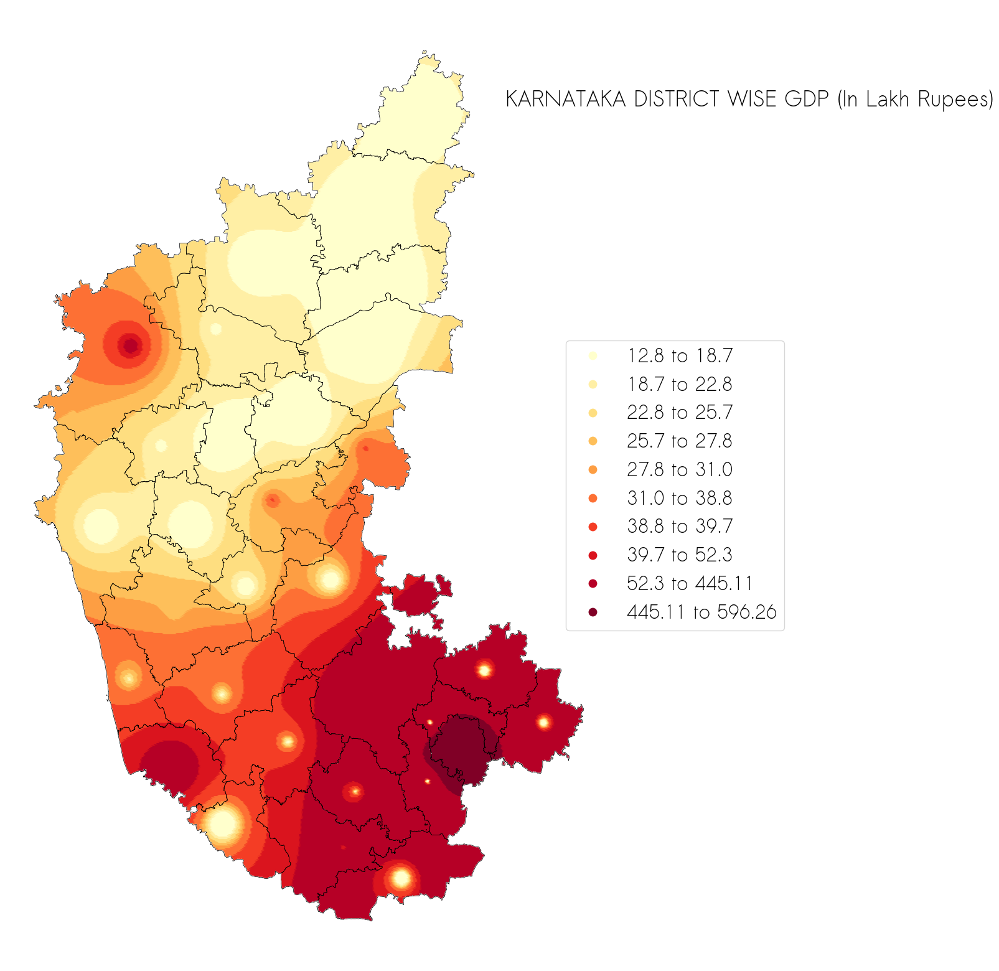

<IPython.core.display.Javascript object>

In [41]:
patches = [
    _PolygonPatch(geom, facecolor="white", edgecolor="white")
    for geom in not_karnataka.geoms
]

fig, ax = plt.subplots(figsize=(20, 20), facecolor="white")

ax.set_facecolor("white")

ax.text(
    0.67,
    0.8,
    "KARNATAKA DISTRICT WISE GDP (In Lakh Rupees)",
    fontname="Sawasdee",
    fontsize=25,
    fontweight=3,
    transform=fig.transFigure,
)

ax.axis("off")

ax = districts.boundary.plot(color="black", linewidth=0.5, ax=ax)
grid.plot(
    ax=ax,
    column="GDDP_Current",
    cmap="YlOrRd",
    linewidth=0.2,
    scheme="percentiles",
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    legend=True,
    legend_kwds={
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
        "loc": "center right",
        "bbox_to_anchor": (1.3, 0.5),
        "prop": {"family": "Sawasdee", "weight": 3, "size": 22},
    },
)
for patch in patches:
    ax.add_patch(patch)

# Interactive Plotting with Geopandas

In [44]:
districts.explore(
    column="GDDP_Current",
    cmap="YlOrRd",
    scheme="percentiles",
    k=10,
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    legend=True,
    legend_kwds={
        "colorbar": False,
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
    },
)

<IPython.core.display.Javascript object>

In [43]:
districts.explore(
    column="GDDP_Current",
    cmap="YlOrRd",
    scheme="percentiles",
    k=10,
    classification_kwds={"pct": [10, 20, 30, 40, 50, 60, 70, 80, 99, 100]},
    tiles=None,
    legend=True,
    legend_kwds={
        "colorbar": False,
        "labels": [
            "12.8 to 18.7",
            "18.7 to 22.8",
            "22.8 to 25.7",
            "25.7 to 27.8",
            "27.8 to 31.0",
            "31.0 to 38.8",
            "38.8 to 39.7",
            "39.7 to 52.3",
            "52.3 to 445.11",
            "445.11 to 596.26",
        ],
    },
)

<IPython.core.display.Javascript object>

# Data Soruces
 * Govt GIS Portals
 * ArcGIS Open Data Hub - https://hub.arcgis.com/
 * Natural Earth - https://www.naturalearthdata.com
 * OpenStreetMap - https://overpass-turbo.eu/ 

# gspatial_plot

* Open Source geospatial plotting library
* seaborn equivalent for geospatial plots
* simplified way to plot popular type of thematic maps
* better default settings
* customization parameters
* built on top of geopandas, cross compatible with geopandas and matplotlib

Star it on Github!: https://github.com/ambeelabs/gspatial_plot